# Energy Demand Prediction: DTSA 5511 Deep Learning Final Project

---

## Contents
1. Introduction and overview of the problem
2. Setup and imports
3. Description of the data, EDA, data prep
4. Modeling
5. Results and analysis
6. Conclusion
7. References

---
## 1. Introduction and overview of the problem

This project is based on a dataset from Kaggle that contains hourly data for electrical consumption, generation, pricing and weather for Spain over a period of 4 years. The data breaks out different types of power generation like coal, natural gas, wind, geothermal, etc. It also provides total and forecasted electrical demand.

As the world tries to migrate it's power generation infrastructure from fossil fuels to renewable energy sources, it has become clear that meeting our future energy needs will require a mix of sources. Every energy source has its downsides. Nuclear power is clean, but the consequences of reactor malfunctions can be disastrous. Wind power is abundant in some parts of the world, but can be unpredictable and requires large installations of unsightly turbines. Solar power has the same downsides as wind, but follows different cycles of supply. Since these different sources of power have different pros and cons, and are available at different times of day, we need to understand how we can stitch these energy sources together to meet our demand for electricity, which has patterns of its own.

The first step in matching the supply and demand of energy is to better understand the pattern of usage, so this is what we will tackle in this project. Energy demand is not a constant over time. We can see the patterns of human life and the natural world reflected in our energy use. In the middle of the night, most people are asleep and businesses are closed, so energy use is low. In the early morning, before the sun provides useful light, usage spikes up quickly as people wake up and turn on lights as they get ready for their day. Starting in the late morning through midday and into the afternoon, power demand dips as people take advantage of the natural light provided by the sun. There is another spike in energy usage in the evening and early night time as people and businesses turn lights on as the sun sets. And finally energy usage drops once again as people go to sleep. This pattern creates a clear 24-hour cycle in power usage. Additionally, since this data comes from Spain where businesses close for the midday siesta, we may see an even stronger dip in midday power consumption.

There are also longer term cycles of seasonality that are caused by the literal seasons of the year. Although the weather in Spain is temperate Mediterranean, it does experience changes in daily temperatures and hours of sunlight, so I expect we'll see year-long patterns in the power usage data.

This dataset provides us with two features of interest for this project: the hourly total power demand, and a corresponding hourly estimate of the power demand, produced by the Spanish Transmission Service Operator. We will measure the Mean Absolute Percent Error in their forecast of power demand, then try to beat their predictions using models of our own. We will set a baseline score using a simple moving average, then we will use the Prophet package from Facebook AI, finally we will try multiple iterations of an LSTM-based model.

---
## 2. Setup and imports

In [1]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
gpu_count = 0
if gpu_info.find('command not found') >= 0:
  print('CUDA not installed')
elif gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)
  gpu_count = !nvidia-smi -L | wc -l
print('GPU count:', gpu_count)

Tue Apr 30 12:59:45 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
from google.colab import userdata, files, drive
# drive.mount('/content/drive')
import os
os.environ["KAGGLE_KEY"] = userdata.get('KAGGLE_KEY')
os.environ["KAGGLE_USERNAME"] = userdata.get('KAGGLE_USERNAME')
import kaggle

In [3]:
# !mkdir /root/.kaggle
# !cp /content/drive/MyDrive/kaggle/kaggle.json /root/.kaggle/
# !chmod 600 /root/.kaggle/kaggle.json
# !kaggle datasets download -d nicholasjhana/energy-consumption-generation-prices-and-weather
!unzip -o -q /content/drive/MyDrive/kaggle/energy_demand/energy-consumption-generation-prices-and-weather.zip -d /content/energy_demand

In [69]:
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import plotly.express as px

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error

from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from tensorflow.keras.callbacks import EarlyStopping

---
## 3. Description of the data, EDA, data prep

This dataset consists of two files, one containing energy production and consumption data, the other containing weather data. The two datasets are aligned spatially and temporally, which would make them very interesting to use for exploring relationships between weather and power usage. In this study, we are focusing on a univariate forecast of power usage, so we will only explore the energy usage and production file.

That file consists of a little over 35,000 rows, representing hourly data, 24 hours a day from Jan 1, 2015 to Dec 31, 2018. There are 29 columns in the data set: a date/time column, 21 columns related to power generated in megawatts from different sources, 2 columns related to weather, 2 columns related to demand and 2 columns related to the price of electricity. We will focus on the two columns related to power demand: "total power forecast" and "total power actual". Both of these columns are provided by the Spanish power utility.

The data was relatively clean. I converted the timestamp from a string to date/time type to help with visualizations. There 8 generation types that had all zeros, so those columns were dropped. There were 292 cases of single data points that were missing. Since this data follows relatively smooth patterns, I decided to linearly interpolate the missing data points to help the time series modeling that follows.

Looking at the energy production numbers, we see that the major sources of power in Spain are unsurprisingly coal and natural gas. What was surprising is that onshore wind and nuclear contribute nearly as much power as the other two fossil fuel sources.

Looking at the demand numbers, we see the expected daily and yearly season patterns as described in the Introduction. The Spanish power utility's predicted demand numbers track very closely with the actuals, as seen in the visualizations and as quantified by the MAPE of __1.10%__. This is the metric we will try to beat, which will be challenging.

In time series analysis, looking at the auto-correlation of the data can provide useful insights. An auto-correlation plot shows how a feature is correlated with itself over different time lags. This can reveal a few things about the data:

1. Are historical values useful for predicting future values?
2. Are there seasonal patterns to the data?
3. How quickly does the correlation drop off over time?

The answers to these questions, as revealed by the auto-correlation plot can provide some hints about how successful we can expect our time series analysis to be, and how many lag features we should build.

In this case, the auto-correlation plot over the entire 4-year period exhibits decay, as expected, but does not go to zero. This means that there is still correlation between today's values and those 4 years ago. This suggests that using historical data to predict future data will be successful on this data set. Zooming in to the beginning of the auto-correlation plot shows significant seasonal patterns. This was expected, based on our previous visualizations, but re-enforces the need to account for seasonal effects as we model the data and generate predictions.

We wrap up this section by applying a MinMax scaler to the data to make it more friendly for ML models, and by applying a test-train split. Test-train split works a little differently in time series data than with normal tabular data sets. Rather than using a random sampling to pick out our test data, the common practice in time series modeling is to train on a contiguous data set at the beginning of the training data, then predict and validate a contiguous data set at the end of the training data. This achieves two things. First by training on contiguous data, we give the model the best chance of picking up on time-based sequences in the data. Secondly, and more importantly, it forces the model to make out-of-sample predictions into the future rather than simply interpolating between past observations.

I used a 20/80 test/train split in this case, which resulted in approximately 28,000 training records and 7,000 test records.

In [5]:
energy_df = pd.read_csv('/content/energy_demand/energy_dataset.csv')
energy_df['time'] = pd.to_datetime(energy_df['time'].str.split('+').str[0], format='%Y-%m-%d %H:%M:%S')
zero_sum_cols = list(energy_df.columns[1:][energy_df.iloc[:, 1:].sum()==0])
energy_df.drop(columns=zero_sum_cols, inplace=True)
energy_df.interpolate(method='linear', inplace=True, axis=0)
energy_df

,time,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,...,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,73.0,49.0,196.0,6378.0,17.0,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,...,71.0,50.0,195.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,...,73.0,50.0,196.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,...,75.0,50.0,191.0,5238.0,2.0,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,...,74.0,42.0,189.0,4935.0,9.0,4861.0,21785.0,20264.0,38.41,56.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35059,2018-12-31 19:00:00,297.0,0.0,7634.0,2628.0,178.0,1.0,1135.0,4836.0,6073.0,...,95.0,85.0,277.0,3113.0,96.0,3253.0,30619.0,30653.0,68.85,77.02
35060,2018-12-31 20:00:00,296.0,0.0,7241.0,2566.0,174.0,1.0,1172.0,3931.0,6074.0,...,95.0,33.0,280.0,3288.0,51.0,3353.0,29932.0,29735.0,68.40,76.16
35061,2018-12-31 21:00:00,292.0,0.0,7025.0,2422.0,168.0,50.0,1148.0,2831.0,6076.0,...,94.0,31.0,286.0,3503.0,36.0,3404.0,27903.0,28071.0,66.88,74.30
35062,2018-12-31 22:00:00,293.0,0.0,6562.0,2293.0,163.0,108.0,1128.0,2068.0,6075.0,...,93.0,31.0,287.0,3586.0,29.0,3273.0,25450.0,25801.0,63.93,69.89


In [114]:
energy_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 21 columns):
 #   Column                                       Non-Null Count  Dtype         
---  ------                                       --------------  -----         
 0   time                                         35064 non-null  datetime64[ns]
 1   generation biomass                           35064 non-null  float64       
 2   generation fossil brown coal/lignite         35064 non-null  float64       
 3   generation fossil gas                        35064 non-null  float64       
 4   generation fossil hard coal                  35064 non-null  float64       
 5   generation fossil oil                        35064 non-null  float64       
 6   generation hydro pumped storage consumption  35064 non-null  float64       
 7   generation hydro run-of-river and poundage   35064 non-null  float64       
 8   generation hydro water reservoir             35064 non-null  float64       


In [6]:
px.line(energy_df, x='time', y=['generation nuclear', 'generation biomass', 'generation fossil gas', 'generation fossil hard coal',
                                'generation wind onshore', 'total load forecast', 'total load actual'])

In [19]:
px.line(energy_df[-300:], x='time', y=['total load forecast', 'total load actual'])

In [89]:
print(f'MAPE: {mean_absolute_percentage_error(energy_df["total load actual"], energy_df["total load forecast"]):.2%}')
print(f'MSE:  {(mean_squared_error(energy_df["total load actual"], energy_df["total load forecast"])**0.5):.0f}')

MAPE: 1.10%
MSE:  455


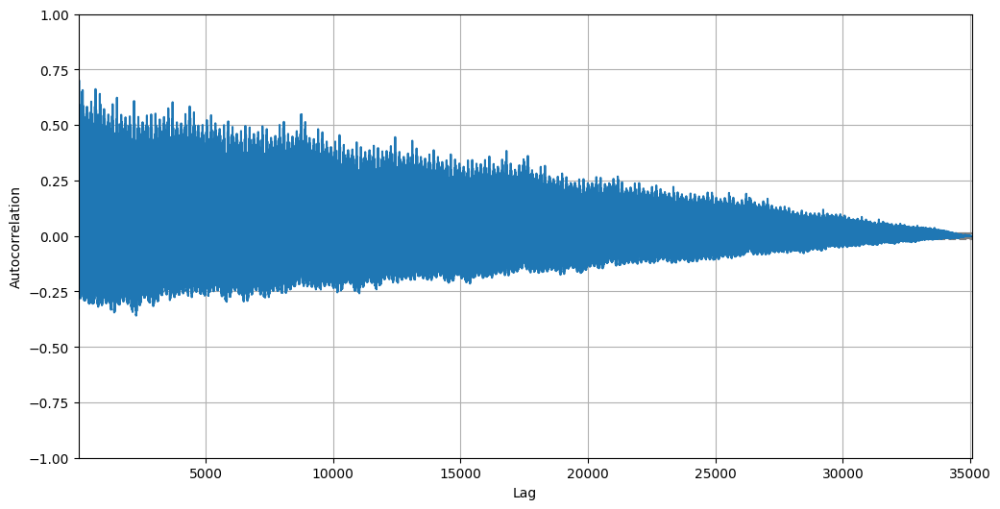

In [130]:
fig = pd.plotting.autocorrelation_plot(energy_df['total load actual'])
fig.figure.set_size_inches(12, 6)

(0.0, 1000.0)

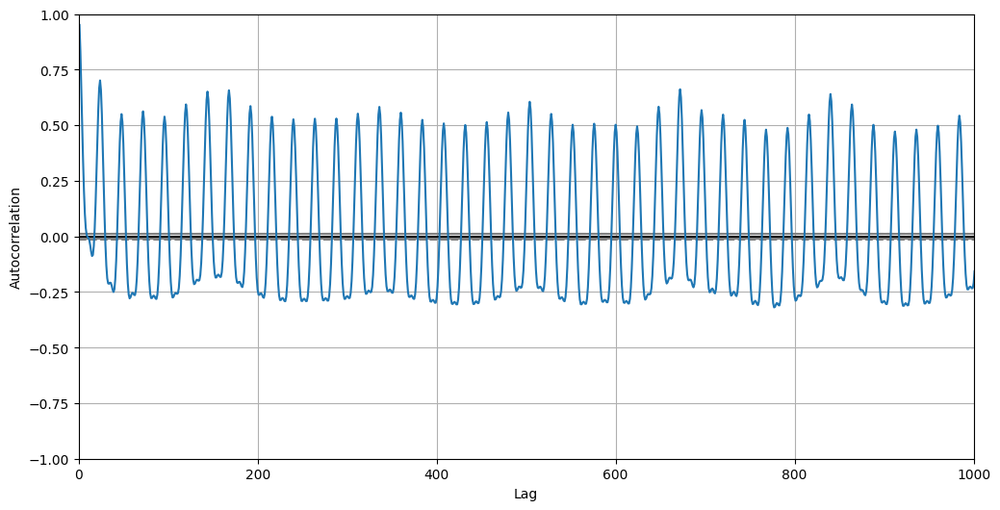

In [129]:
fig = pd.plotting.autocorrelation_plot(energy_df['total load actual'])
fig.figure.set_size_inches(12, 6)
fig.set_xlim(0, 1000)

In [11]:
total_load_actual = energy_df['total load actual'].dropna().values.astype('float32').reshape(-1, 1)
total_load_actual.shape

(35064, 1)

In [12]:
scaler = MinMaxScaler()
total_load_actual = scaler.fit_transform(total_load_actual)

In [13]:
train_fraction = 0.8
train, test = np.split(total_load_actual, [int(len(total_load_actual)*train_fraction)])
train.shape, test.shape

((28051, 1), (7013, 1))

---
## 4. Modeling

In order to predict the total energy demand, we used 3 different types of model. We will first set a baseline using a very simple moving average model, then we will use Facebook Prophet, and finally we will train multiple LSTM models, using different architectures, callbacks and learning rates.

__Summary of model iterations:__

1. Baseline: Simple moving average with a 30-period window.

2. Prophet: Using out of the box settings, no additional regressors.

3. LSTM 1: Starter configuration to make sure everything works.

4. LSTM 2: Increased window size to 100, more LSTM units, more training epochs, added early stopping.

5. LSTM 3: Increased window size to 168 (7 days), more training epochs.

6. LSTM 4: Added 100-unit Dense layer.

7. LSTM 5: Added exponential decay learning rate function.

See Section 5: Results for in-depth discussion of the evolution of the models and the resulting evaluation scores.

---
### Baseline

In [115]:
moving_avg_window = 30
baseline_df = pd.DataFrame(energy_df['time'])
baseline_df['Prediction'] = energy_df['total load actual'].rolling(moving_avg_window).mean()
baseline_df['Actual'] = energy_df['total load actual']
baseline_df

,time,Prediction,Actual
0,2015-01-01 00:00:00,NaN,25385.0
1,2015-01-01 01:00:00,NaN,24382.0
2,2015-01-01 02:00:00,NaN,22734.0
3,2015-01-01 03:00:00,NaN,21286.0
4,2015-01-01 04:00:00,NaN,20264.0
...,...,...,...
35059,2018-12-31 19:00:00,26374.866667,30653.0
35060,2018-12-31 20:00:00,26457.233333,29735.0
35061,2018-12-31 21:00:00,26526.200000,28071.0
35062,2018-12-31 22:00:00,26542.466667,25801.0


In [116]:
fig = px.line(baseline_df, x='time', y=['Prediction', 'Actual'],
              labels={'time': 'Time',
                      'value': 'Total Demand'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [117]:
fig = px.line(baseline_df[-300:], x='time', y=['Prediction', 'Actual'],
              labels={'time': 'Time',
                      'value': 'Total Demand'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [118]:
print(f'MAPE: {mean_absolute_percentage_error(baseline_df.iloc[moving_avg_window:]["Actual"], baseline_df.iloc[moving_avg_window:]["Prediction"]):.2%}')
print(f'MSE:  {(mean_squared_error(baseline_df.iloc[moving_avg_window:]["Actual"], baseline_df.iloc[moving_avg_window:]["Prediction"])**0.5):.0f}')

MAPE: 11.49%
MSE:  3828


---
### Prophet

In [22]:
train_fraction = 0.8
m_train, m_test = np.split(energy_df[['time', 'total load actual']], [int(len(energy_df)*train_fraction)])
m_train.columns = ['ds', 'y']
m_test.columns = ['ds', 'y']
m_train.shape, m_test.shape

((28051, 2), (7013, 2))

In [23]:
m = Prophet()
m.fit(m_train)

DEBUG:cmdstanpy:input tempfile: /tmp/tmpix78a_wp/dobol5j6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpix78a_wp/m0gq8j0d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13440', 'data', 'file=/tmp/tmpix78a_wp/dobol5j6.json', 'init=/tmp/tmpix78a_wp/m0gq8j0d.json', 'output', 'file=/tmp/tmpix78a_wp/prophet_modeldo2cip_p/prophet_model-20240430131131.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
13:11:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
13:11:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [24]:
future = pd.DataFrame(energy_df['time'])
future.columns = ['ds']
future.tail()

,ds
35059,2018-12-31 19:00:00
35060,2018-12-31 20:00:00
35061,2018-12-31 21:00:00
35062,2018-12-31 22:00:00
35063,2018-12-31 23:00:00


In [25]:
forecast = m.predict(future)

In [26]:
plot_plotly(m, forecast, trend=True, xlabel='Date', ylabel='Total Demand')

In [119]:
m_results = pd.DataFrame(energy_df['time'])
m_results['Prediction'] = forecast['yhat']
m_results['Actual'] = energy_df['total load actual']

In [120]:
fig = px.line(m_results, x='time', y=['Prediction', 'Actual'],
              labels={'time': 'Time',
                      'value': 'Total Demand'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [121]:
fig = px.line(m_results[-300:], x='time', y=['Prediction', 'Actual'],
              labels={'time': 'Time',
                      'value': 'Total Demand'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [122]:
print(f'MAPE: {mean_absolute_percentage_error(m_results["Actual"], m_results["Prediction"]):.2%}')
print(f'MSE:  {(mean_squared_error(m_results["Actual"], m_results["Prediction"])**0.5):.0f}')

MAPE: 7.02%
MSE:  2658


---
### LSTM 1

In [31]:
def create_sequences(data, window_size):
    X = []
    y = []
    for i in range(len(data) - window_size):
        # Extract a sequence of window_size elements
        sequence = data[i:(i + window_size)]
        X.append(sequence)
        # Append the next element after the sequence as the target
        y.append(data[i + window_size])
    return np.array(X), np.array(y)

In [32]:
tf.keras.backend.clear_session()

window_size = 1
X_train, y_train = create_sequences(train, window_size)
X_test, y_test = create_sequences(test, window_size)
print(f'X_train shape: {X_train.shape}, y_train shape: {y_train.shape}')
print(f'X_test shape: {X_test.shape}, y_test shape: {y_test.shape}')
print(f'LSTM input shape: {X_train.shape[1], X_train.shape[2]}')

X_train shape: (28050, 1, 1), y_train shape: (28050, 1)
X_test shape: (7012, 1, 1), y_test shape: (7012, 1)
LSTM input shape: (1, 1)


In [33]:
input_shape = (X_train.shape[1], X_train.shape[2])
lstm_units = 10
dropout = 0.2
output_units = 1

model_1 = Sequential()
model_1.add(LSTM(lstm_units, input_shape=input_shape))
model_1.add(Dropout(dropout))
model_1.add(Dense(output_units))
model_1.compile(optimizer='adam', loss='mean_squared_error')

model_1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 10)                480       
                                                                 
 dropout (Dropout)           (None, 10)                0         
                                                                 
 dense (Dense)               (None, 1)                 11        
                                                                 
Total params: 491 (1.92 KB)
Trainable params: 491 (1.92 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [34]:
history_1 = model_1.fit(X_train, y_train,
                      epochs=10,
                      batch_size=32,
                      validation_data=(X_test, y_test),
                      shuffle=False
                      )

Epoch 1/10
877/877 [==============================] - 8s 4ms/step - loss: 0.0287 - val_loss: 0.0056
Epoch 2/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0084 - val_loss: 0.0038
Epoch 3/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0066 - val_loss: 0.0038
Epoch 4/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0057 - val_loss: 0.0038
Epoch 5/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0053 - val_loss: 0.0038
Epoch 6/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0050 - val_loss: 0.0038
Epoch 7/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0049 - val_loss: 0.0037
Epoch 8/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0048 - val_loss: 0.0037
Epoch 9/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0047 - val_loss: 0.0037
Epoch 10/10
877/877 [==============================] - 3s 4ms/step - loss: 0.0047 - val_loss: 0.0037

In [35]:
fig = px.line(history_1.history,
              labels={'value': 'Loss',
                      'index': 'Epoch'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [36]:
train_preds_1 = model_1.predict(X_train[window_size:])
test_preds_1 = model_1.predict(X_test[window_size:])

220/220 [==============================] - 0s 2ms/step


In [37]:
preds_1 = np.concatenate((train_preds_1, test_preds_1), axis=0)
preds_1 = scaler.inverse_transform(preds_1)
preds_1 = preds_1.reshape(-1)

In [38]:
y_train_1 = scaler.inverse_transform(y_train)
y_test_1 = scaler.inverse_transform(y_test)
y_1 = np.concatenate((y_train_1[window_size:].reshape(-1), y_test_1[window_size:].reshape(-1)), axis=0)

In [39]:
results_df = energy_df['time'][2 * window_size:train.shape[0]]

In [40]:
results_df = pd.DataFrame(np.concatenate([energy_df['time'][2 * window_size:train.shape[0]],
                                          energy_df['time'][train.shape[0] + 2 * window_size:]]))
results_df.columns = ['time']
results_df['preds'] = preds_1
results_df['y'] = y_1

In [41]:
fig = px.line(results_df, x='time', y=['preds', 'y'],
              labels={'value': 'Total Demand',
                      'time': 'time'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [42]:
fig = px.line(results_df[-300:], x='time', y=['preds', 'y'],
              labels={'value': 'Total Demand',
                      'time': 'time'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [92]:
print(f'MAPE: {mean_absolute_percentage_error(y_1, preds_1):.2%}')
print(f'MSE:  {(mean_squared_error(y_1, preds_1)**0.5):.0f}')

MAPE: 4.02%
MSE:  1432


---
### LSTM 2

Larger window size, more epochs, early stopping

In [53]:
early_stopping_cb = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)

In [54]:
window_size = 100
X_train, y_train = create_sequences(train, window_size)
X_test, y_test = create_sequences(test, window_size)
print(f'X_train shape: {X_train.shape}, y_train shape: {y_train.shape}')
print(f'X_test shape: {X_test.shape}, y_test shape: {y_test.shape}')
print(f'LSTM input shape: {X_train.shape[1], X_train.shape[2]}')

X_train shape: (27951, 100, 1), y_train shape: (27951, 1)
X_test shape: (6913, 100, 1), y_test shape: (6913, 1)
LSTM input shape: (100, 1)


In [55]:
input_shape = (X_train.shape[1], X_train.shape[2])
lstm_units = 100
dropout = 0.2
output_units = 1

model_2 = Sequential()
model_2.add(LSTM(lstm_units, input_shape=input_shape))
model_2.add(Dropout(dropout))
model_2.add(Dense(output_units))
model_2.compile(optimizer='adam', loss='mean_squared_error')

model_2.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 100)               40800     
                                                                 
 dropout_3 (Dropout)         (None, 100)               0         
                                                                 
 dense_3 (Dense)             (None, 1)                 101       
                                                                 
Total params: 40901 (159.77 KB)
Trainable params: 40901 (159.77 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [56]:
history_2 = model_2.fit(X_train, y_train,
                        epochs=50,
                        batch_size=32,
                        validation_data=(X_test, y_test),
                        callbacks=[early_stopping_cb],
                        shuffle=False
                        )

Epoch 1/50
874/874 [==============================] - 7s 7ms/step - loss: 0.0115 - val_loss: 0.0028
Epoch 2/50
874/874 [==============================] - 6s 7ms/step - loss: 0.0033 - val_loss: 0.0017
Epoch 3/50
874/874 [==============================] - 6s 6ms/step - loss: 0.0025 - val_loss: 0.0014
Epoch 4/50
874/874 [==============================] - 6s 7ms/step - loss: 0.0019 - val_loss: 0.0011
Epoch 5/50
874/874 [==============================] - 5s 6ms/step - loss: 0.0017 - val_loss: 0.0010
Epoch 6/50
874/874 [==============================] - 6s 7ms/step - loss: 0.0016 - val_loss: 0.0010
Epoch 7/50
874/874 [==============================] - 6s 7ms/step - loss: 0.0014 - val_loss: 9.0750e-04
Epoch 8/50
874/874 [==============================] - 6s 7ms/step - loss: 0.0013 - val_loss: 8.8479e-04
Epoch 9/50
874/874 [==============================] - 6s 6ms/step - loss: 0.0012 - val_loss: 8.1574e-04
Epoch 10/50
874/874 [==============================] - 6s 6ms/step - loss: 0.0012 - val_

In [81]:
fig = px.line(history_2.history,
              labels={'value': 'Loss',
                      'index': 'Epoch'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [82]:
train_preds_2 = model_2.predict(X_train[window_size:])
test_preds_2 = model_2.predict(X_test[window_size:])

213/213 [==============================] - 1s 3ms/step


In [83]:
preds_2 = np.concatenate((train_preds_2, test_preds_2), axis=0)
preds_2 = scaler.inverse_transform(preds_2)
preds_2 = preds_2.reshape(-1)

y_train_2 = scaler.inverse_transform(y_train)
y_test_2 = scaler.inverse_transform(y_test)
y_2 = np.concatenate((y_train_2[window_size:].reshape(-1), y_test_2[window_size:].reshape(-1)), axis=0)

results_2_df = energy_df['time'][2 * window_size:train.shape[0]]

results_2_df = pd.DataFrame(np.concatenate([energy_df['time'][2 * window_size:train.shape[0]],
                                            energy_df['time'][train.shape[0] + 2 * window_size:]]))
results_2_df.columns = ['time']
results_2_df['preds'] = preds_2
results_2_df['y'] = y_2

In [84]:
fig = px.line(results_2_df, x='time', y=['preds', 'y'],
              labels={'value': 'Total Demand',
                      'time': 'time'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [85]:
fig = px.line(results_2_df[-300:], x='time', y=['preds', 'y'],
              labels={'value': 'Total Demand',
                      'time': 'time'})
fig.update_layout(legend=dict(title='',
                              yanchor="top", y=0.99,
                              xanchor="right", x=0.99))
fig.show()

In [93]:
print(f'MAPE: {mean_absolute_percentage_error(y_2, preds_2):.2%}')
print(f'MSE:  {(mean_squared_error(y_2, preds_2)**0.5):.0f}')

MAPE: 1.29%
MSE:  551
